In [2]:
# Common imports
import numpy as np
import os
import seaborn as sns
from sklearn.preprocessing import Imputer

# To plot pretty figures
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12


import seaborn as sns # for making plots with seaborn
color = sns.color_palette()
import plotly.offline as py
py.init_notebook_mode(connected=True)
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.offline as offline
offline.init_notebook_mode()
import plotly.tools as tls
import squarify
from numpy import array
from matplotlib import cm

import datetime

# to make this notebook's output stable across runs
np.random.seed(42)

# Where to save the figures
PROJECT_ROOT_DIR = "."
CHAPTER_ID = ""
IMAGES_PATH = os.path.join(PROJECT_ROOT_DIR, "images", CHAPTER_ID)

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = os.path.join(IMAGES_PATH, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)


In [3]:
import pandas as pd
data_wiki = pd.read_csv("./datasets/data_wiki_clean.csv", parse_dates=['birthdate'])
data_imdb = pd.read_csv("./datasets/data_imdb_clean.csv", parse_dates=['birthdate'])


In [4]:
data_wiki.head()

,full_path,gender,name,photo_taken,full_path_crop,birthdate,year_birth,month_birth,weekday_birth,day_birth,age,filesize,filesize_crop
0,./datasets/wiki/17/10000217_1981-05-05_2009.jpg,1.0,u'Sami Jauhoj\xe4rvi',2009,./datasets/wiki_crop/17/10000217_1981-05-05_20...,1981-05-05,1981.0,5.0,1.0,5.0,28.0,28550,12592
1,./datasets/wiki/48/10000548_1925-04-04_1964.jpg,1.0,u'Dettmar Cramer',1964,./datasets/wiki_crop/48/10000548_1925-04-04_19...,1925-04-04,1925.0,4.0,5.0,4.0,39.0,58113,8685
2,./datasets/wiki/12/100012_1948-07-03_2008.jpg,1.0,u'Marc Okrand',2008,./datasets/wiki_crop/12/100012_1948-07-03_2008...,1948-07-03,1948.0,7.0,5.0,3.0,60.0,28498,24432
3,./datasets/wiki/65/10001965_1930-05-23_1961.jpg,1.0,u'Aleksandar Matanovi\u0107',1961,./datasets/wiki_crop/65/10001965_1930-05-23_19...,1930-05-23,1930.0,5.0,4.0,23.0,31.0,38036,14696
4,./datasets/wiki/16/10002116_1971-05-31_2012.jpg,0.0,u'Diana Damrau',2012,./datasets/wiki_crop/16/10002116_1971-05-31_20...,1971-05-31,1971.0,5.0,0.0,31.0,41.0,49139,5791


In [5]:
data_wiki[data_wiki['age']==0]

,full_path,gender,name,photo_taken,full_path_crop,birthdate,year_birth,month_birth,weekday_birth,day_birth,age,filesize,filesize_crop
1489,./datasets/wiki/92/42009092_2014-02-20_2014.jpg,0.0,"u'Princess Leonore, Duchess of Gotland'",2014,./datasets/wiki_crop/92/42009092_2014-02-20_20...,2014-02-20,2014.0,2.0,3.0,20.0,0.0,47312,3376
34183,./datasets/wiki/48/26614448_1940-04-30_1940.jpg,1.0,u'Oleksiy Kartunov',1940,./datasets/wiki_crop/48/26614448_1940-04-30_19...,1940-04-30,1940.0,4.0,1.0,30.0,0.0,26522,14096
42749,./datasets/wiki/34/32851434_1960-12-16_1960.jpg,1.0,u'Mark Porter',1960,./datasets/wiki_crop/34/32851434_1960-12-16_19...,1960-12-16,1960.0,12.0,4.0,16.0,0.0,55324,38029


In [6]:
data_imdb[data_imdb['age']==0]

,full_path,gender,name,photo_taken,full_path_crop,birthdate,year_birth,month_birth,weekday_birth,day_birth,age,filesize_crop
98433,./datasets/imdb/52/nm0001152_rm1139929344_1965...,0.0,u'Illeana Douglas',1965,./datasets/imdb_crop/52/nm0001152_rm1139929344...,1965-07-25,1965,7,6,25,0,40887
127479,./datasets/imdb/64/nm0001764_rm1747561216_1963...,1.0,u'John Stamos',1963,./datasets/imdb_crop/64/nm0001764_rm1747561216...,1963-08-19,1963,8,0,19,0,26498
219876,./datasets/imdb/44/nm4314944_rm1222553088_2010...,0.0,u'Rylie Cregut',2010,./datasets/imdb_crop/44/nm4314944_rm1222553088...,2010-02-12,2010,2,4,12,0,8925
219877,./datasets/imdb/44/nm4314944_rm1423879680_2010...,0.0,u'Rylie Cregut',2010,./datasets/imdb_crop/44/nm4314944_rm1423879680...,2010-02-12,2010,2,4,12,0,3599
219880,./datasets/imdb/44/nm4314944_rm3492392448_2010...,0.0,u'Rylie Cregut',2010,./datasets/imdb_crop/44/nm4314944_rm3492392448...,2010-02-12,2010,2,4,12,0,19800
219881,./datasets/imdb/44/nm4314944_rm3593055744_2010...,0.0,u'Rylie Cregut',2010,./datasets/imdb_crop/44/nm4314944_rm3593055744...,2010-02-12,2010,2,4,12,0,24150
219882,./datasets/imdb/44/nm4314944_rm959819008_2010-...,0.0,u'Rylie Cregut',2010,./datasets/imdb_crop/44/nm4314944_rm959819008_...,2010-02-12,2010,2,4,12,0,23484
219883,./datasets/imdb/44/nm4314944_rm976596224_2010-...,0.0,u'Rylie Cregut',2010,./datasets/imdb_crop/44/nm4314944_rm976596224_...,2010-02-12,2010,2,4,12,0,4016
227362,./datasets/imdb/49/nm0614249_rm3025372160_1964...,0.0,u'Erin Murphy',1964,./datasets/imdb_crop/49/nm0614249_rm3025372160...,1964-06-17,1964,6,2,17,0,47288
291241,./datasets/imdb/77/nm0837177_rm1099407360_1975...,1.0,u'Jason Sudeikis',1975,./datasets/imdb_crop/77/nm0837177_rm1099407360...,1975-09-18,1975,9,3,18,0,21471


In [7]:
data_wiki['gender'].mean()

0.7670271111283986

# 1. Gender

In [14]:
data_wiki['gender'].value_counts()

1.0    39439
0.0    11979
Name: gender, dtype: int64

In [16]:
temp.index

Float64Index([1.0, 0.0], dtype='float64')

In [18]:
temp = data_wiki['gender'].value_counts()
labels = ['Male','Female']
sizes = (temp / temp.sum())*100
trace = go.Pie(labels=labels, values=sizes, hoverinfo='label+percent')
layout = go.Layout(title='Gender Wikipedia dataset')
data = [trace]
fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

In [20]:
temp = data_imdb['gender'].value_counts()
labels = ['Male','Female']
sizes = (temp / temp.sum())*100
trace = go.Pie(labels=labels, values=sizes, hoverinfo='label+percent')
layout = go.Layout(title='Gender IMDB dataset')
data = [trace]
fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

('Saving figure', '1-gender-wiki')


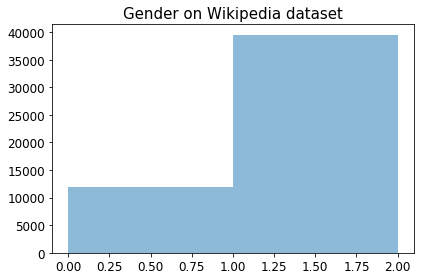

In [19]:
plt.hist(data_wiki.gender, bins=2,range=[0,2], alpha=0.5)
plt.title('Gender on Wikipedia dataset', fontsize=15)
#plt.yscale('log')
save_fig("1-gender-wiki")

('Saving figure', '1-gender-wiki')


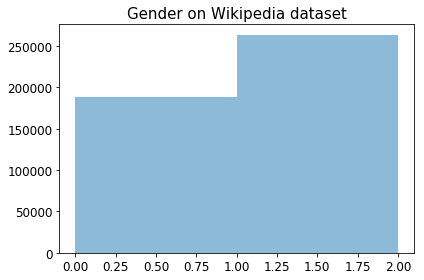

In [21]:
plt.hist(data_imdb.gender, bins=2,range=[0,2], alpha=0.5)
plt.title('Gender on Wikipedia dataset', fontsize=15)
#plt.yscale('log')
save_fig("1-gender-wiki")

# 2. Age

In [8]:
temp = data_wiki["age"].value_counts()
temp_y0 = []
temp_y1 = []
for val in temp.index:
    temp_y1.append(np.sum(data_wiki["gender"][data_wiki["age"]==val] == 1))
    temp_y0.append(np.sum(data_wiki["gender"][data_wiki["age"]==val] == 0))    
trace1 = go.Bar(
    x = temp.index,
    y = temp_y1,
    name='Male'
)
trace2 = go.Bar(
    x = temp.index,
    y = temp_y0, 
    name='Female'
)

data = [trace1, trace2]
layout = go.Layout(
    title = "Age on Wikipedia dataset",
    barmode='stack',
    width = 1000,
    xaxis=dict(range=[0, 100])
)

fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

In [9]:
dict(range=[0, 100])

{'range': [0, 100]}

('Saving figure', '0-age-wiki')


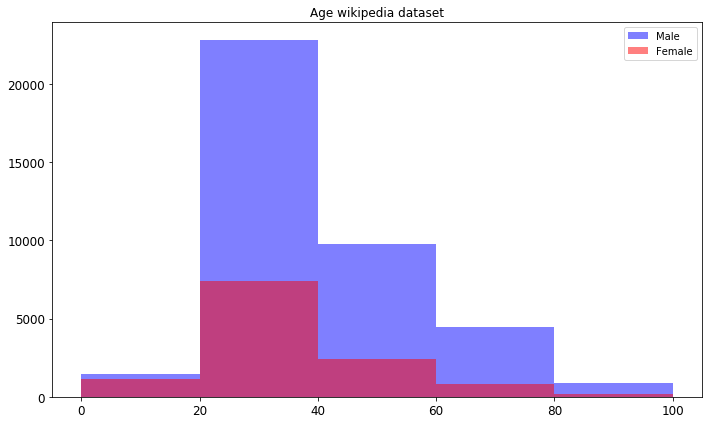

In [12]:
plt.figure(figsize=(10, 6))

plt.hist(data_wiki[data_wiki.gender==1].age,bins=5,range=[0,100],alpha=0.5, label='Male',color='b')
plt.hist(data_wiki[data_wiki.gender==0].age,bins=5,range=[0,100],alpha=0.5, label='Female',color='r')

plt.title("Age wikipedia dataset")
plt.legend()

save_fig("0-age-wiki")

In [26]:
temp = data_imdb["age"].value_counts()
temp_y0 = []
temp_y1 = []
for val in temp.index:
    temp_y1.append(np.sum(data_imdb["gender"][data_imdb["age"]==val] == 1))
    temp_y0.append(np.sum(data_imdb["gender"][data_imdb["age"]==val] == 0))    
trace1 = go.Bar(
    x = temp.index,
    y = temp_y1,
    name='Male'
)
trace2 = go.Bar(
    x = temp.index,
    y = temp_y0, 
    name='Female'
)

data = [trace1, trace2]
layout = go.Layout(
    title = "Age on IMDB dataset",
    barmode='stack',
    width = 1000,
    xaxis=dict(range=[0, 100])
)

fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

('Saving figure', '0-age-imdb')


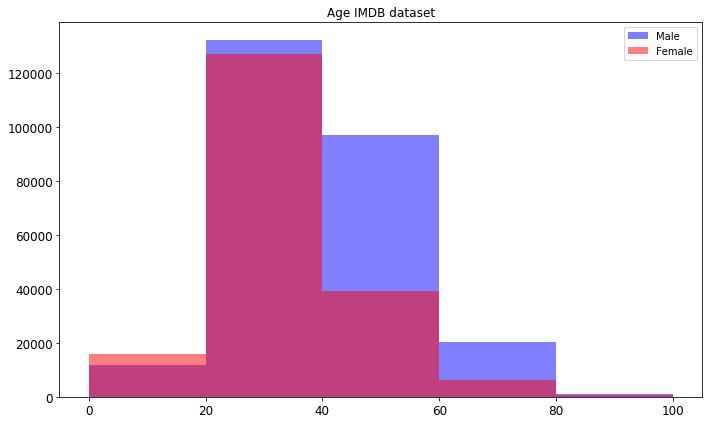

In [14]:
plt.figure(figsize=(10, 6))

plt.hist(data_imdb[data_imdb.gender==1].age,bins=5,range=[0,100],alpha=0.5, label='Male',color='b')
plt.hist(data_imdb[data_imdb.gender==0].age,bins=5,range=[0,100],alpha=0.5, label='Female',color='r')

plt.title("Age IMDB dataset")
plt.legend()

save_fig("0-age-imdb")

# 3. Birth time analysis

## 3.1 Year of birth

In [30]:
temp = data_wiki["year_birth"].value_counts()
temp_y0 = []
temp_y1 = []
for val in temp.index:
    temp_y1.append(np.sum(data_wiki["gender"][data_wiki["year_birth"]==val] == 1))
    temp_y0.append(np.sum(data_wiki["gender"][data_wiki["year_birth"]==val] == 0))    
trace1 = go.Bar(
    x = temp.index,
    y = temp_y1,
    name='Male'
)
trace2 = go.Bar(
    x = temp.index,
    y = temp_y0, 
    name='Female'
)

data = [trace1, trace2]
layout = go.Layout(
    title = "Year of birth on Wikipedia dataset",
    barmode='stack',
    width = 1000,
    xaxis=dict(range=[1850, 2018])
)

fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

In [31]:
temp = data_imdb["year_birth"].value_counts()
temp_y0 = []
temp_y1 = []
for val in temp.index:
    temp_y1.append(np.sum(data_imdb["gender"][data_imdb["year_birth"]==val] == 1))
    temp_y0.append(np.sum(data_imdb["gender"][data_imdb["year_birth"]==val] == 0))    
trace1 = go.Bar(
    x = temp.index,
    y = temp_y1,
    name='Male'
)
trace2 = go.Bar(
    x = temp.index,
    y = temp_y0, 
    name='Female'
)

data = [trace1, trace2]
layout = go.Layout(
    title = "Year of birth on IMDB dataset",
    barmode='stack',
    width = 1000,
    xaxis=dict(range=[1850, 2018])
)

fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

## 3.2 Month of birth

In [32]:
temp = data_wiki["month_birth"].value_counts()
#print(temp.values)
temp_y0 = []
temp_y1 = []
for val in temp.index:
    temp_y1.append(np.sum(data_wiki["gender"][data_wiki["month_birth"]==val] == 1))
    temp_y0.append(np.sum(data_wiki["gender"][data_wiki["month_birth"]==val] == 0))
    
trace1 = go.Bar(
    x = temp.index,
    y = temp_y1,
    name='Male'
)
trace2 = go.Bar(
    x = temp.index,
    y = temp_y0, 
    name='Female'
)

data = [trace1, trace2]
layout = go.Layout(
    title = "Month of birth on Wikipedia dataset",
    barmode='stack',
    width = 1000
)

fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

In [33]:
temp = data_imdb["month_birth"].value_counts()
#print(temp.values)
temp_y0 = []
temp_y1 = []
for val in temp.index:
    temp_y1.append(np.sum(data_imdb["gender"][data_imdb["month_birth"]==val] == 1))
    temp_y0.append(np.sum(data_imdb["gender"][data_imdb["month_birth"]==val] == 0))
    
trace1 = go.Bar(
    x = temp.index,
    y = temp_y1,
    name='Male'
)
trace2 = go.Bar(
    x = temp.index,
    y = temp_y0, 
    name='Female'
)

data = [trace1, trace2]
layout = go.Layout(
    title = "Month of birth on IMDB dataset",
    barmode='stack',
    width = 1000
)

fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

## 3.3 Week day of birth

In [34]:
temp = data_wiki["weekday_birth"].value_counts()
#print(temp.values)
temp_y0 = []
temp_y1 = []
for val in temp.index:
    temp_y1.append(np.sum(data_wiki["gender"][data_wiki["weekday_birth"]==val] == 1))
    temp_y0.append(np.sum(data_wiki["gender"][data_wiki["weekday_birth"]==val] == 0))
    
trace1 = go.Bar(
    x = temp.index,
    y = temp_y1,
    name='Male'
)
trace2 = go.Bar(
    x = temp.index,
    y = temp_y0, 
    name='Female'
)

data = [trace1, trace2]
layout = go.Layout(
    title = "Week day of birth on Wikipedia dataset",
    barmode='stack',
    width = 1000
)

fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

In [35]:
temp = data_imdb["weekday_birth"].value_counts()
#print(temp.values)
temp_y0 = []
temp_y1 = []
for val in temp.index:
    temp_y1.append(np.sum(data_imdb["gender"][data_imdb["weekday_birth"]==val] == 1))
    temp_y0.append(np.sum(data_imdb["gender"][data_imdb["weekday_birth"]==val] == 0))
    
trace1 = go.Bar(
    x = temp.index,
    y = temp_y1,
    name='Male'
)
trace2 = go.Bar(
    x = temp.index,
    y = temp_y0, 
    name='Female'
)

data = [trace1, trace2]
layout = go.Layout(
    title = "Week day of birth on IMDB dataset",
    barmode='stack',
    width = 1000
)

fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

# 4. Photo time

In [36]:
temp = data_wiki["photo_taken"].value_counts()
#print(temp.values)
temp_y0 = []
temp_y1 = []
for val in temp.index:
    temp_y1.append(np.sum(data_wiki["gender"][data_wiki["photo_taken"]==val] == 1))
    temp_y0.append(np.sum(data_wiki["gender"][data_wiki["photo_taken"]==val] == 0))
    
trace1 = go.Bar(
    x = temp.index,
    y = temp_y1,
    name='Male'
)
trace2 = go.Bar(
    x = temp.index,
    y = temp_y0, 
    name='Female'
)

data = [trace1, trace2]
layout = go.Layout(
    title = "Year of photo on Wikipedia dataset",
    barmode='stack',
    width = 1000
)

fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

In [37]:
temp = data_imdb["photo_taken"].value_counts()
#print(temp.values)
temp_y0 = []
temp_y1 = []
for val in temp.index:
    temp_y1.append(np.sum(data_imdb["gender"][data_imdb["photo_taken"]==val] == 1))
    temp_y0.append(np.sum(data_imdb["gender"][data_imdb["photo_taken"]==val] == 0))
    
trace1 = go.Bar(
    x = temp.index,
    y = temp_y1,
    name='Male'
)
trace2 = go.Bar(
    x = temp.index,
    y = temp_y0, 
    name='Female'
)

data = [trace1, trace2]
layout = go.Layout(
    title = "Year of photo on IMDB dataset",
    barmode='stack',
    width = 1000
)

fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

## 5. File size

In [47]:
temp = data_wiki
#print(temp.values)
temp_y0 = temp[temp["gender"]==0]["filesize_crop"]
temp_y1 = temp[temp["gender"]==1]["filesize_crop"]

trace1 = go.Histogram(
    x = temp_y1,
    name='Male'
)
trace2 = go.Histogram(
    x = temp_y0,
    name='Female'
)

data = [trace1, trace2]
layout = go.Layout(
    title = "File size of photo on Wikipedia dataset",
    barmode='stack',
    width = 1000,
    xaxis=dict(range=[0, 50000])

)

fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

In [48]:
temp = data_imdb
#print(temp.values)
temp_y0 = temp[temp["gender"]==0]["filesize_crop"]
temp_y1 = temp[temp["gender"]==1]["filesize_crop"]

trace1 = go.Histogram(
    x = temp_y1,
    name='Male'
)
trace2 = go.Histogram(
    x = temp_y0,
    name='Female'
)

data = [trace1, trace2]
layout = go.Layout(
    title = "File size of photo on IMDB dataset",
    barmode='stack',
    width = 1000,
    xaxis=dict(range=[0, 50000])

)

fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

# 6. Display some photos

In [52]:
data_wiki['full_path_crop'][100]

'./datasets/wiki_crop/47/1005947_1968-04-18_2007.jpg'

In [73]:
for i,t in enumerate(temp['full_path_crop']):
    print (i, t)

(0, './datasets/wiki_crop/20/70020_1896-01-20_1986.jpg')
(1, './datasets/wiki_crop/82/1202882_1924-01-03_2014.jpg')
(2, './datasets/wiki_crop/37/7203237_1866-07-03_1956.jpg')
(3, './datasets/wiki_crop/76/24074576_1878-01-19_1968.jpg')
(4, './datasets/wiki_crop/47/16061647_1921-10-04_2011.jpg')
(5, './datasets/wiki_crop/74/29074_1920-02-25_2010.jpg')
(6, './datasets/wiki_crop/76/1116776_1912-10-28_2002.jpg')
(7, './datasets/wiki_crop/28/13101528_1905-10-28_1995.jpg')
(8, './datasets/wiki_crop/32/151532_1915-02-04_2005.jpg')
(9, './datasets/wiki_crop/14/33239414_1925-02-19_2015.jpg')
(10, './datasets/wiki_crop/89/30388889_1919-08-31_2009.jpg')
(11, './datasets/wiki_crop/07/40396407_1923-02-16_2013.jpg')
(12, './datasets/wiki_crop/91/6232491_1925-11-04_2015.jpg')
(13, './datasets/wiki_crop/26/333026_1920-01-01_2010.jpg')
(14, './datasets/wiki_crop/29/16347929_1920-07-13_2010.jpg')
(15, './datasets/wiki_crop/48/19313148_1922-05-09_2012.jpg')
(16, './datasets/wiki_crop/94/11469494_1923-05-3

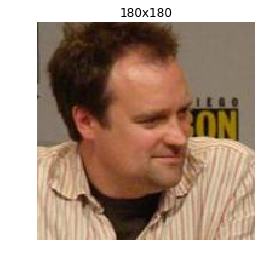

In [67]:
import matplotlib.image as mpimg
test_image = mpimg.imread(data_wiki['full_path_crop'][100])
plt.title("{}x{}".format(test_image.shape[1], test_image.shape[0]))
plt.imshow(test_image)
plt.axis("off")
plt.show()

('Age:', 5)


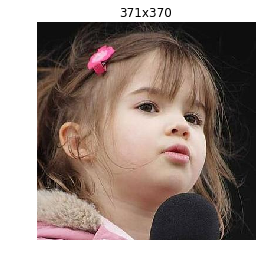

('Age:', 10)


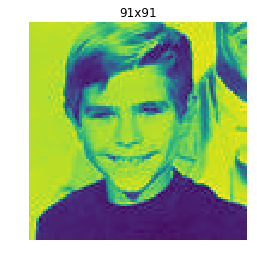

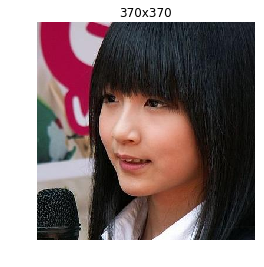

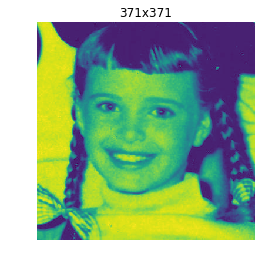

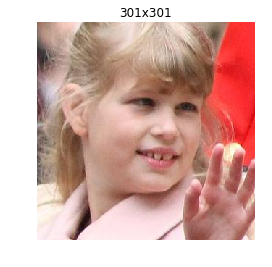

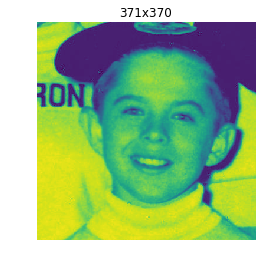

('Age:', 15)


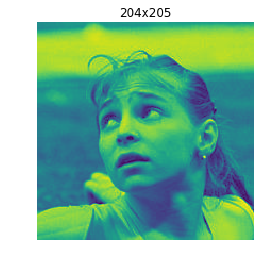

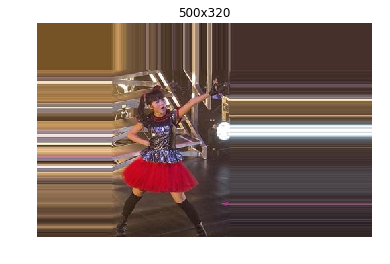

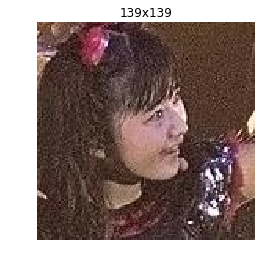

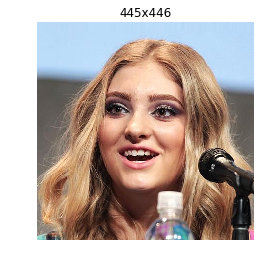

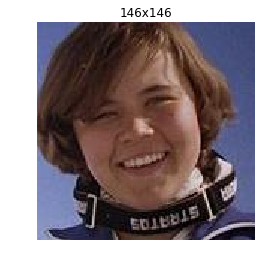

('Age:', 20)


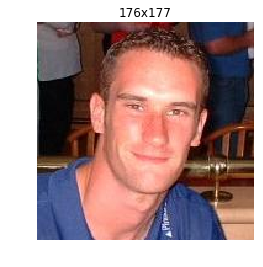

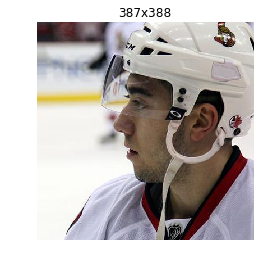

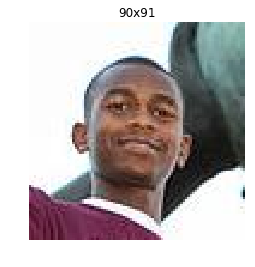

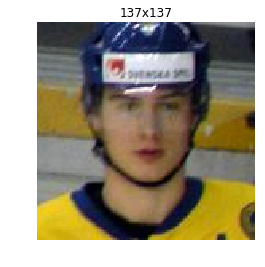

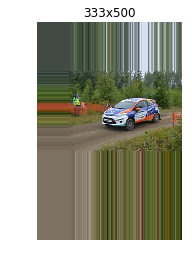

('Age:', 30)


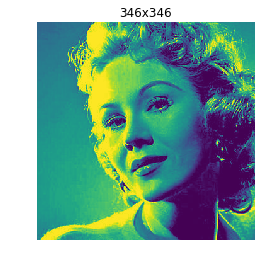

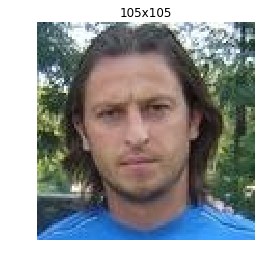

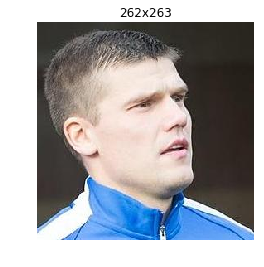

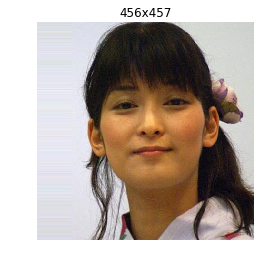

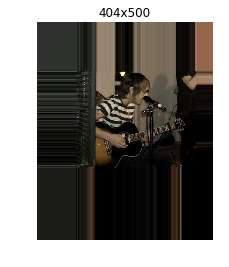

('Age:', 40)


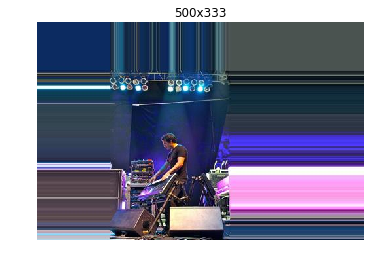

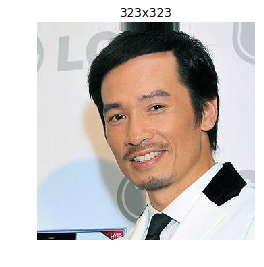

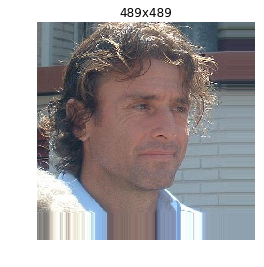

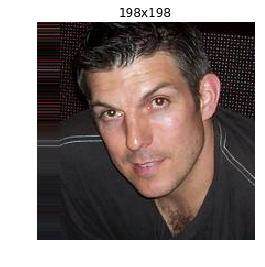

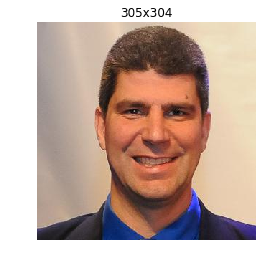

('Age:', 50)


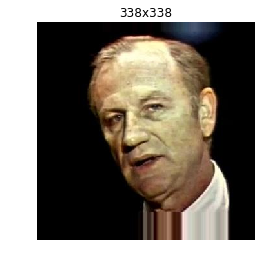

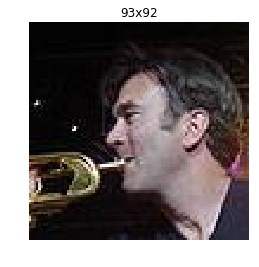

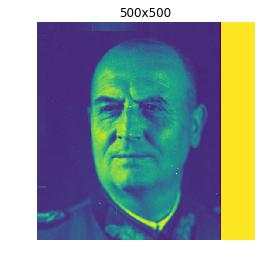

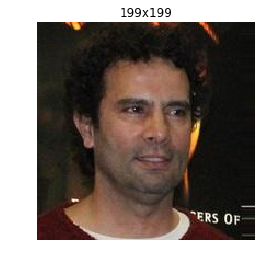

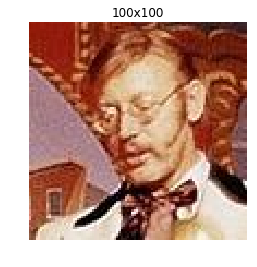

('Age:', 60)


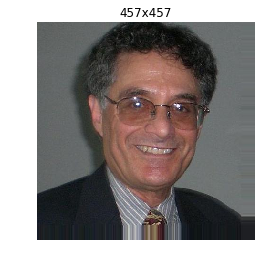

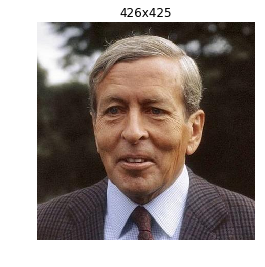

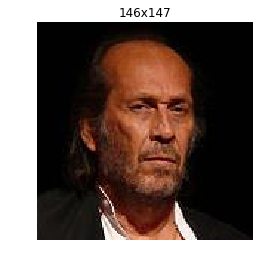

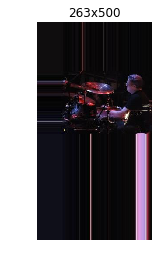

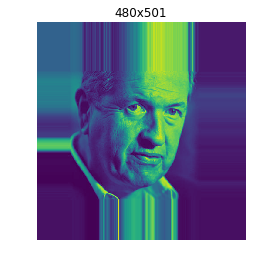

('Age:', 70)


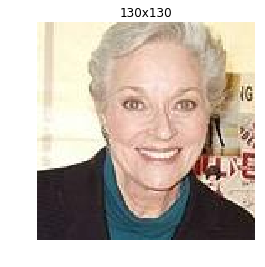

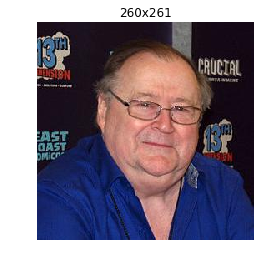

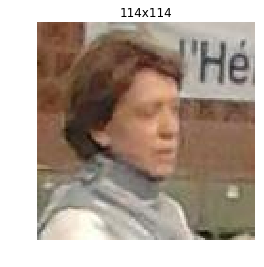

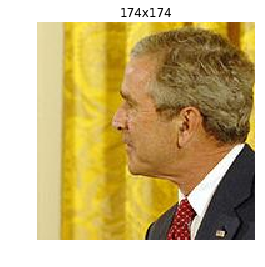

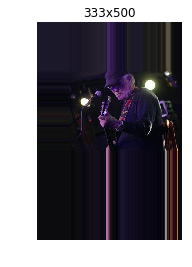

('Age:', 80)


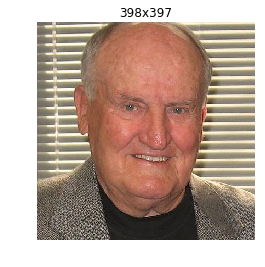

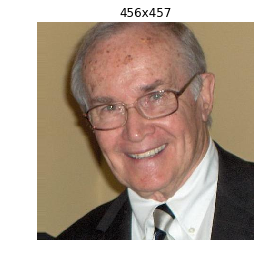

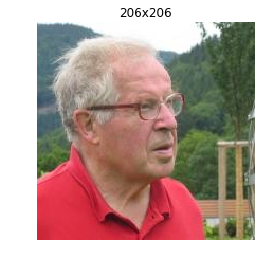

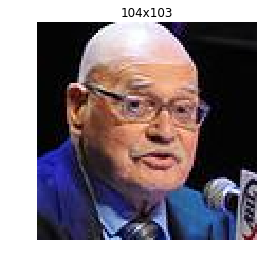

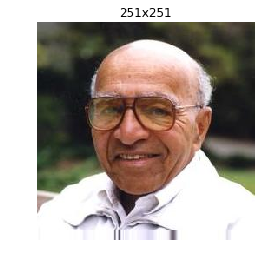

('Age:', 90)


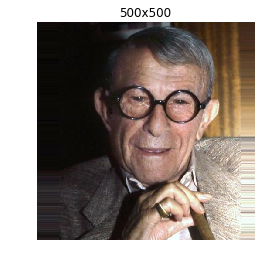

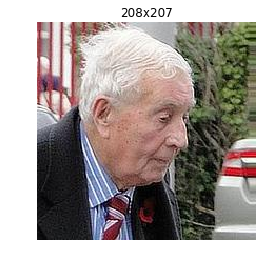

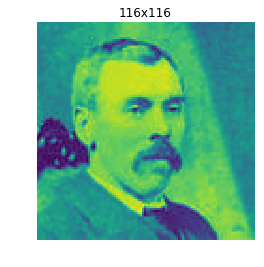

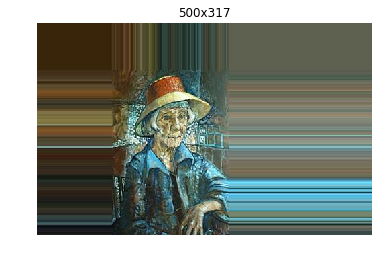

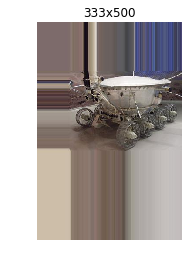

('Age:', 100)


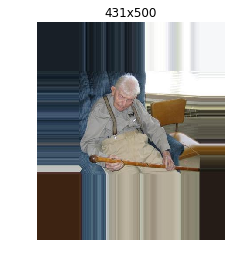

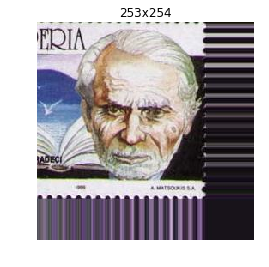

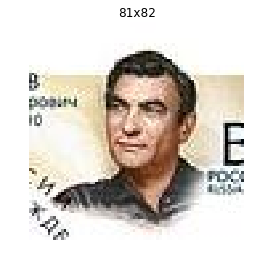

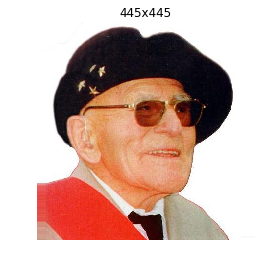

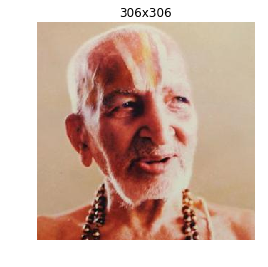

In [97]:
nexamples = 5
for age in [5, 10, 15, 20, 30, 40, 50, 60, 70, 80, 90, 100]:
    print("Age:", age)
    temp = data_wiki[data_wiki['age']==age]
    for i,t in enumerate(temp['full_path_crop']):
        if (i==nexamples):break
        test_image = mpimg.imread(t)
        plt.title("{}x{}".format(test_image.shape[1], test_image.shape[0]))
        plt.imshow(test_image)
        plt.axis("off")
        plt.show()

('Age:', 5)


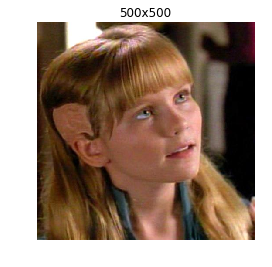

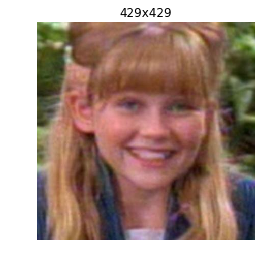

('Age:', 10)


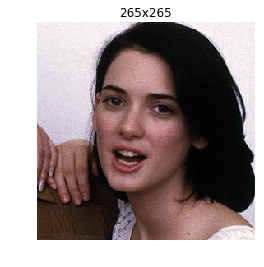

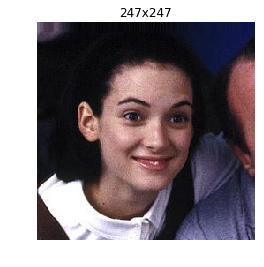

('Age:', 12)


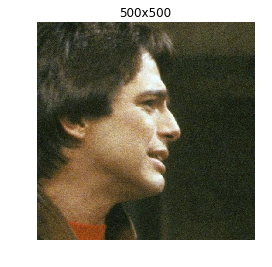

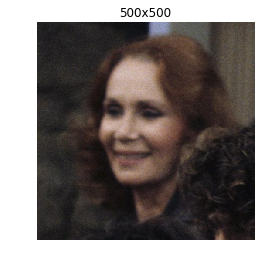

('Age:', 20)


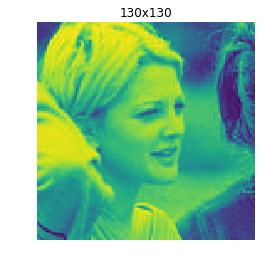

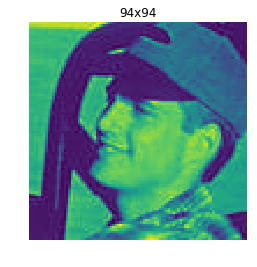

('Age:', 30)


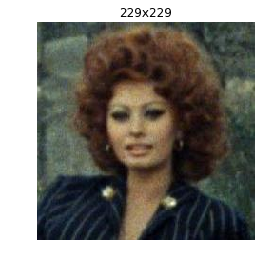

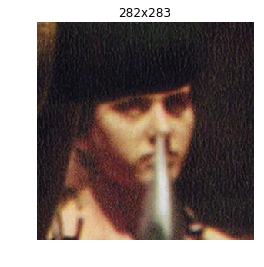

('Age:', 40)


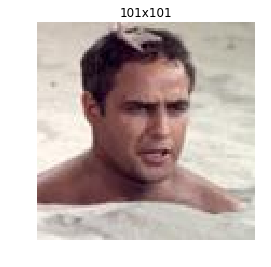

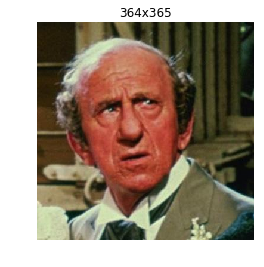

('Age:', 50)


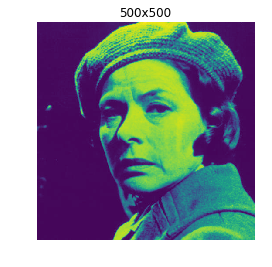

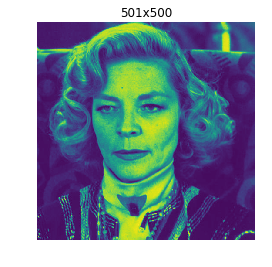

('Age:', 60)


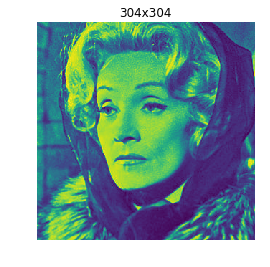

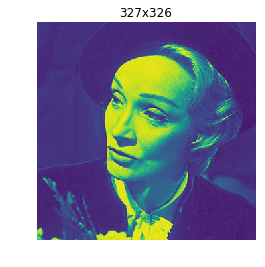

('Age:', 70)


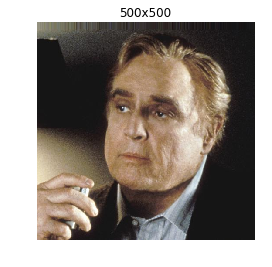

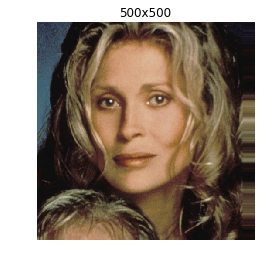

('Age:', 80)


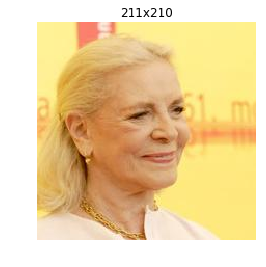

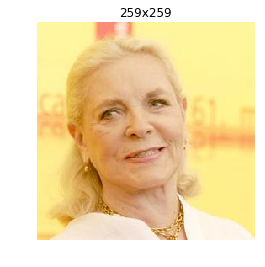

('Age:', 90)


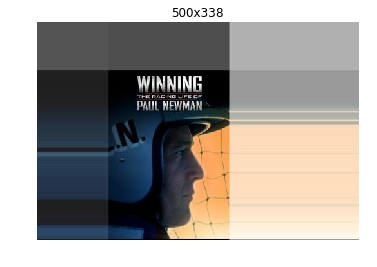

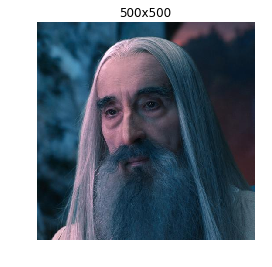

('Age:', 100)


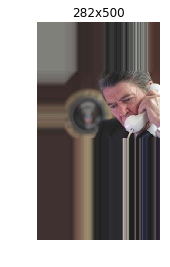

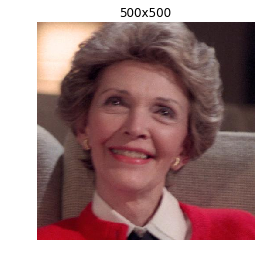

In [96]:
nexamples = 2
for age in [5, 10, 12, 20, 30, 40, 50, 60, 70, 80, 90, 100]:
    print("Age:", age)
    temp = data_imdb[data_imdb['age']==age]
    for i,t in enumerate(temp['full_path_crop']):
        if (i==nexamples):break
        test_image = mpimg.imread(t)
        plt.title("{}x{}".format(test_image.shape[1], test_image.shape[0]))
        plt.imshow(test_image)
        plt.axis("off")
        plt.show()